In [101]:
import numpy as np
import pandas as pd
import matplotlib as plt
import seaborn as sns
import plotly.express as px

In [107]:
df=pd.read_csv('../data/processed/data.csv')

In [108]:
df=df.sample(10000).reset_index()

In [10]:
df.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,dropoff_year,dropoff_month,dropoff_day,dropoff_day_of_week,pickup_year,pickup_month,pickup_day,pickup_day_of_week,distance_in_km
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,N,455,2016,3,14,0,2016,3,14,0,1.498521
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,N,663,2016,6,12,6,2016,6,12,6,1.805507
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,N,2124,2016,1,19,1,2016,1,19,1,6.385098
3,id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010040,40.719971,-74.012268,40.706718,N,429,2016,4,6,2,2016,4,6,2,1.485498
4,id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973053,40.793209,-73.972923,40.782520,N,435,2016,3,26,5,2016,3,26,5,1.188588


## Vendor id

In [4]:
df['vendor_id'].value_counts()

vendor_id
2    780302
1    678342
Name: count, dtype: int64

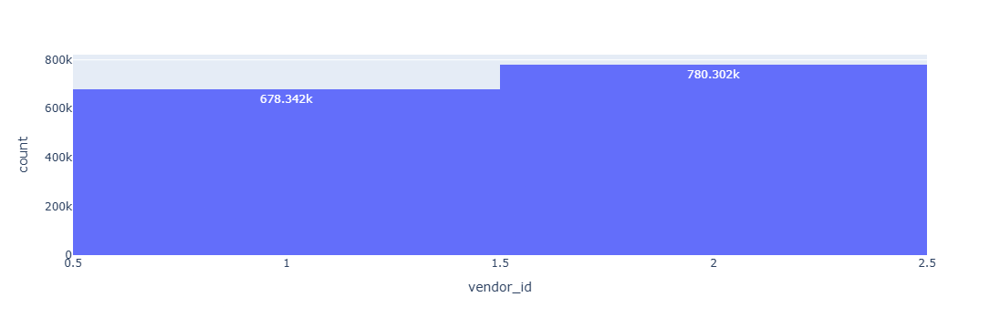

In [5]:
px.histogram(df,x='vendor_id',text_auto=True)

## datetime cols

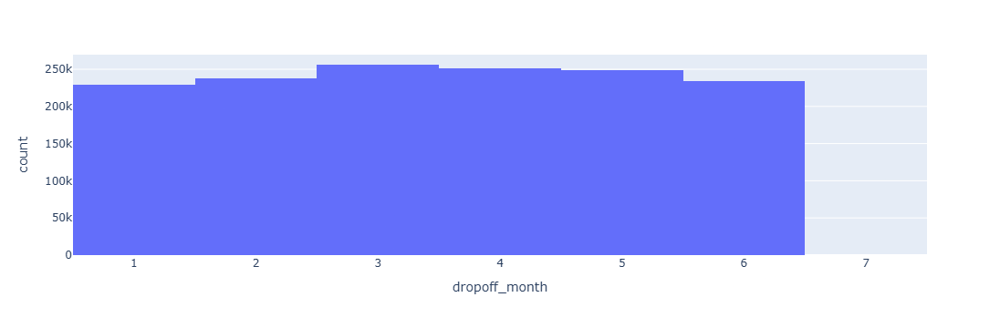

In [6]:
px.histogram(df,'dropoff_month')

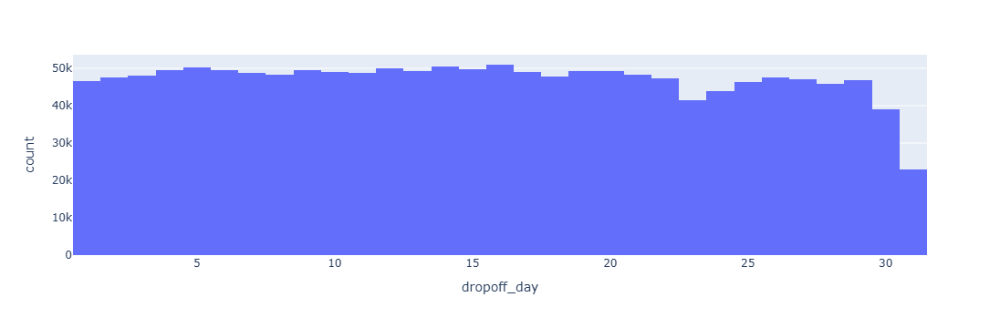

In [7]:
px.histogram(df,'dropoff_day')

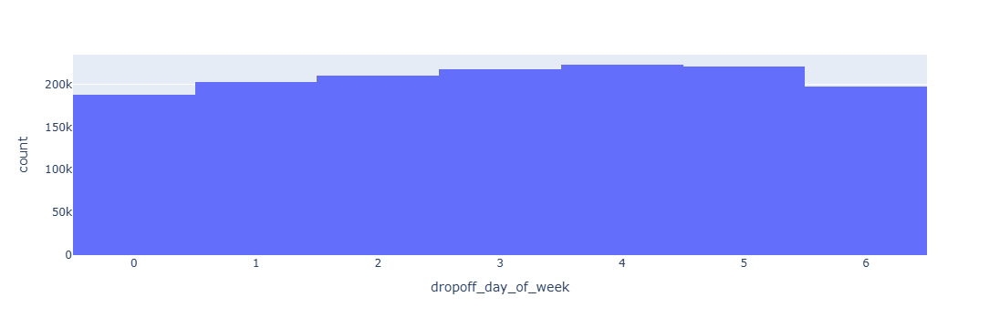

In [8]:
px.histogram(df,'dropoff_day_of_week')

## dist in km

In [12]:
df['distance_in_km'].describe()

count    1.458644e+06
mean     3.440864e+00
std      4.296538e+00
min      0.000000e+00
25%      1.231837e+00
50%      2.093717e+00
75%      3.875337e+00
max      1.240909e+03
Name: distance_in_km, dtype: float64

In [22]:
from scipy.stats.mstats import winsorize
bins_q = winsorize(df['distance_in_km'], limits=(0.00, 0.05))

In [28]:
from sklearn.preprocessing import KBinsDiscretizer
kb=KBinsDiscretizer(strategy='uniform',encode='ordinal',n_bins=50)
bins_q_c=kb.fit_transform(np.array(bins_q).reshape(len(bins_q),1))

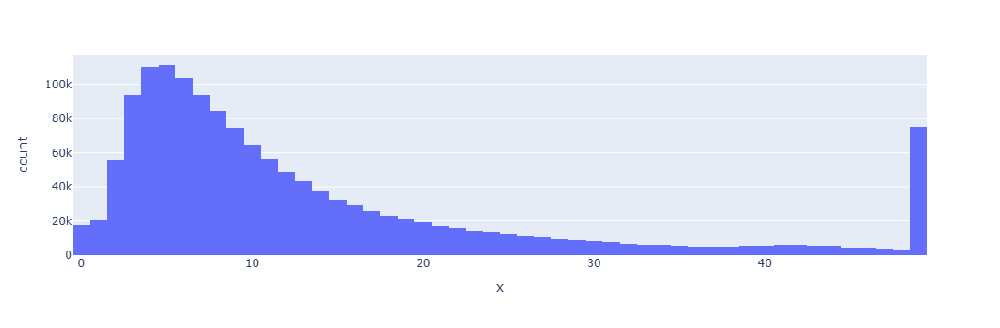

In [31]:
px.histogram(x=bins_q_c.ravel())

In [33]:
count_dct={}
for k in bins_q_c.ravel():
    count_dct[k]=count_dct.get(k,0)+1

In [48]:
count_dct=dict(sorted(count_dct.items()))

In [61]:
cum_sum_=np.cumsum(np.array(list(count_dct.values())))

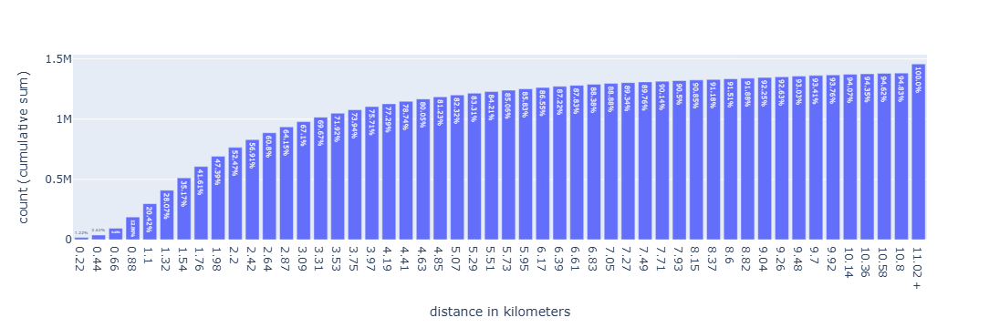

In [92]:
px.bar(x=[f"{round(kb.bin_edges_[0][i],2)}" if i!=len(kb.bin_edges_[0])-1 else f"{round(kb.bin_edges_[0][i],2)} + " for i in range(1,len(kb.bin_edges_[0]))],y=cum_sum_,text=[f"{round(i*100/sum(count_dct.values()),2)}%" for i in cum_sum_],labels={'x':'distance in kilometers','y':'count (cumulative sum)'})

## passenger count

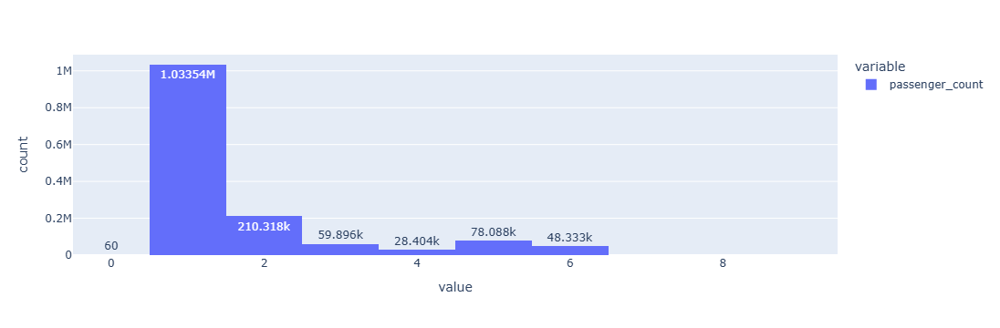

In [99]:
px.histogram(df['passenger_count'],text_auto=True)

In [97]:
df['passenger_count'].value_counts()

passenger_count
1    1033540
2     210318
5      78088
3      59896
6      48333
4      28404
0         60
7          3
9          1
8          1
Name: count, dtype: int64

## trip duration

In [110]:
df['trip_duration'].describe()

count    10000.000000
mean       961.029000
std       3358.900622
min          2.000000
25%        402.000000
50%        659.000000
75%       1070.000000
max      86338.000000
Name: trip_duration, dtype: float64

In [114]:
from scipy.stats.mstats import winsorize
bins_q = winsorize(df['trip_duration'], limits=(0.00, 0.05))

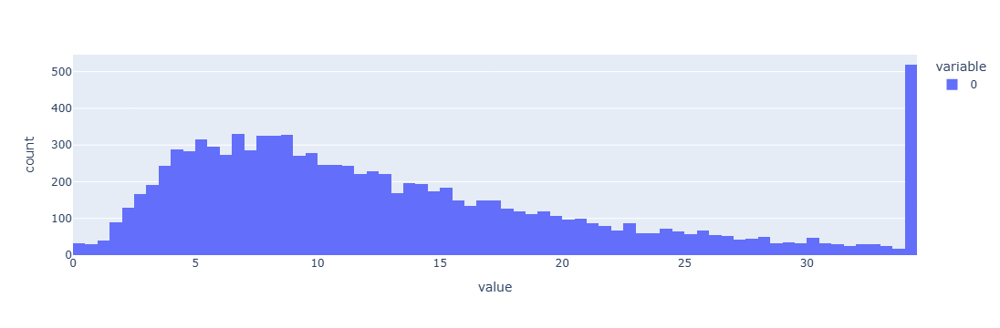

In [116]:
px.histogram(bins_q/60)

# multivariate

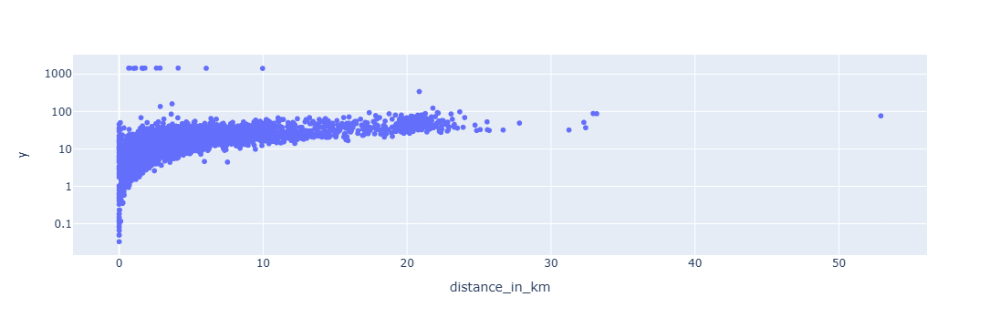

In [118]:
px.scatter(df,x='distance_in_km',y=df['trip_duration']/60,log_y=True)

## Pickup month vs other cols

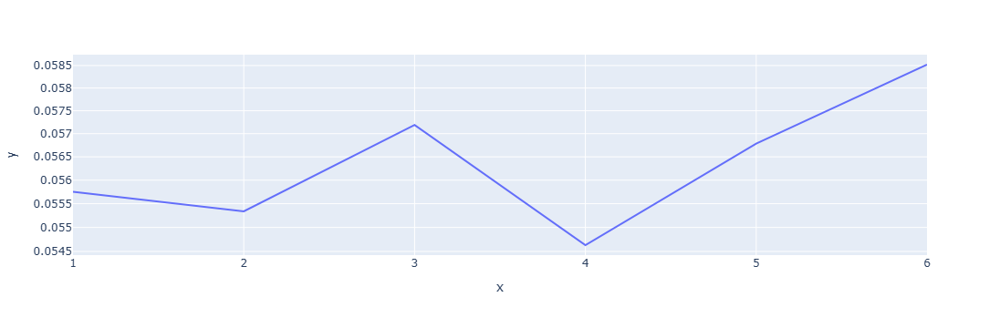

In [130]:
X=df.groupby(by='pickup_month')['distance_in_km'].mean()
px.line(x=X.index,y=X.values/60,log_y=True)

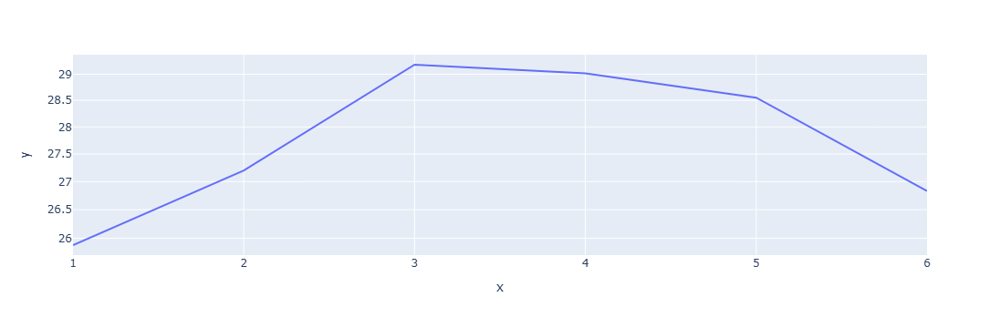

In [135]:
X=df.groupby(by='pickup_month')['distance_in_km'].count()
px.line(x=X.index,y=X.values/60,log_y=True)

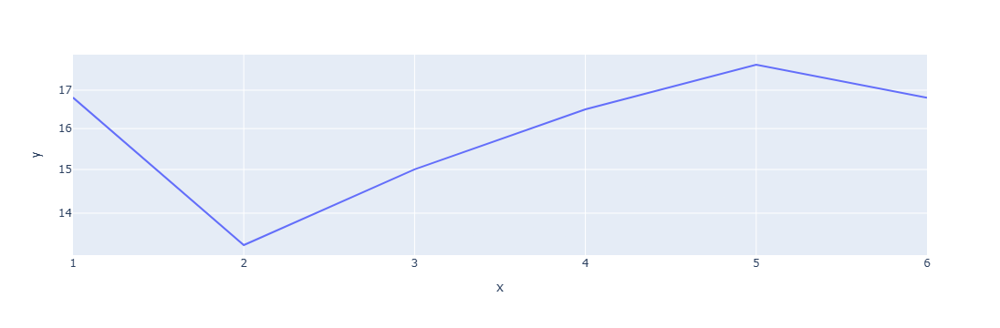

In [129]:
X=df.groupby(by='pickup_month')['trip_duration'].mean()
px.line(x=X.index,y=X.values/60,log_y=True)

## Pickup day vs other cols

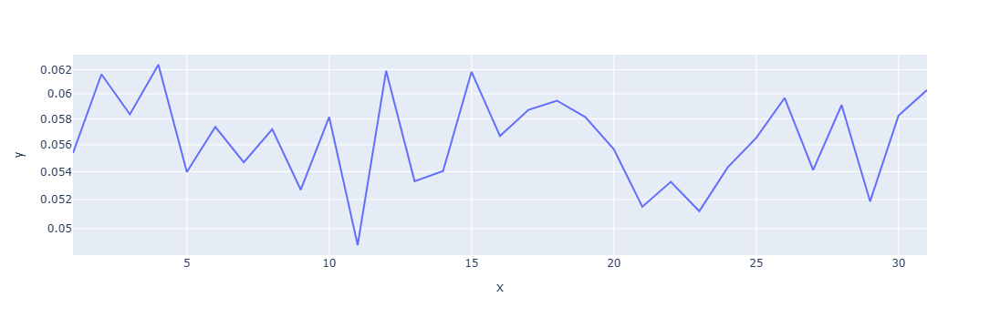

In [131]:
X=df.groupby(by='pickup_day')['distance_in_km'].mean()
px.line(x=X.index,y=X.values/60,log_y=True)

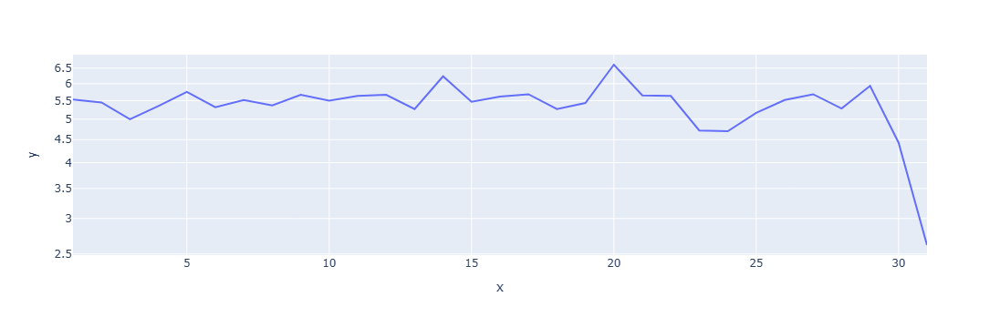

In [136]:
X=df.groupby(by='pickup_day')['distance_in_km'].count()
px.line(x=X.index,y=X.values/60,log_y=True)

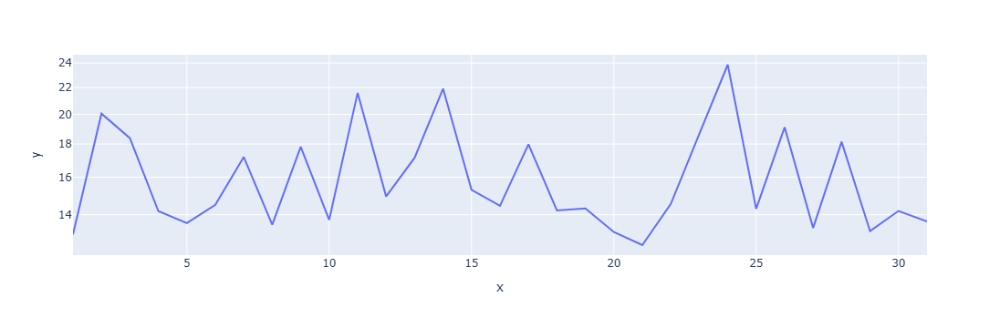

In [132]:
X=df.groupby(by='pickup_day')['trip_duration'].mean()
px.line(x=X.index,y=X.values/60,log_y=True)

## Pickup day of week vs other cols

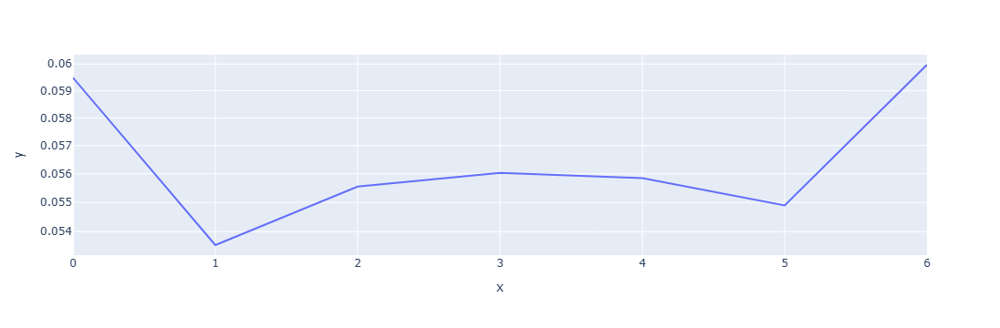

In [133]:
X=df.groupby(by='pickup_day_of_week')['distance_in_km'].mean()
px.line(x=X.index,y=X.values/60,log_y=True)

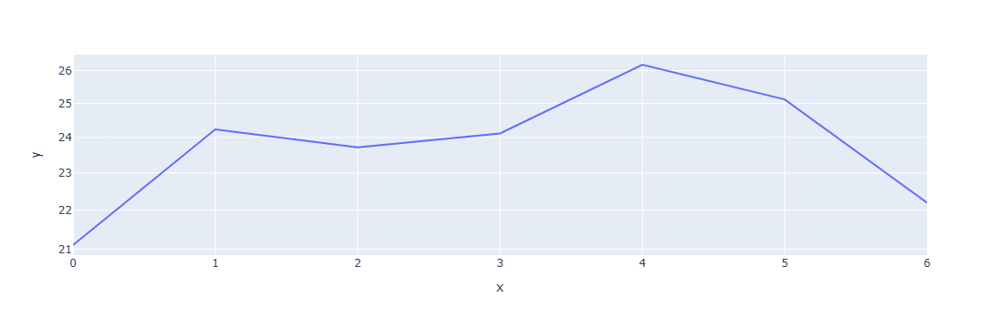

In [137]:
X=df.groupby(by='pickup_day_of_week')['distance_in_km'].count()
px.line(x=X.index,y=X.values/60,log_y=True)

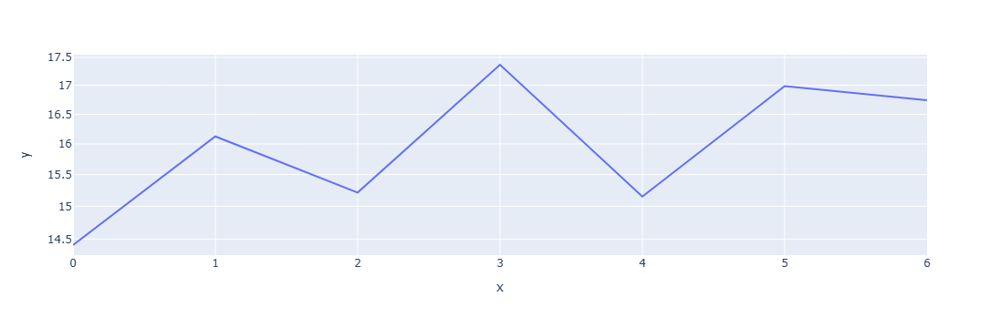

In [134]:
X=df.groupby(by='pickup_day_of_week')['trip_duration'].mean()
px.line(x=X.index,y=X.values/60,log_y=True)